In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
import pandas as pd
import os
from scipy import stats
import numpy as np
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import json

In [7]:
cases_data = json.load(open('./Data/NorthSea_extracted.json'))
nuw = 0.066666667
nun = 0.066666667
Fz = 5e-06
porosity = 0.2301818
volume = 750*1000^2

# Get vo, vp, and vm for each curve (case)

In [8]:
K_d = 900 #mDarcy
voxel_length_to_mdarcy = 1000*(2.3**2)/0.9869233 #mdarcy/voxel
K = K_d/voxel_length_to_mdarcy # k in 'voxel length**2'

for case in cases_data:
    krw = [i/K for i in case['krwc']] # keff to kr
    krn = [i/K for i in case['krnc']]
    sw = case['sw']
    l = len(case['sw'])
    
    #get vp for all points 
    vp_vo = [nuw * ((i/nuw)+(j/nun)) for i, j in zip(krw,krn)] #vp/vo
    
    # get vm using the derivative of vp/vo
    d_vp_vo_dsw = []
    vm_vo = []
    for i in range (l):
        if i ==0: #first point, forward derivative
            d_vp_vo_i = vp_vo[i+1]- vp_vo[i]  # d(vp/vo)
            d_sw_i = sw[i+1] - sw[i] # dSw
            
        elif i == (l-1): #last point, backward derivative
            d_vp_vo_i = vp_vo[i]- vp_vo[i-1] 
            d_sw_i = sw[i] - sw[i-1] 
            
        else: # intermediate points, take the average of the forward and backward derivatives
            d_vp_vo_i = 0.5 * ((vp_vo[i+1]- vp_vo[i]) + (vp_vo[i]- vp_vo[i-1]))
            d_sw_i = 0.5 * ((sw[i+1] - sw[i]) + (sw[i] - sw[i-1]))
            
        d_vp_vo_dsw_i = d_vp_vo_i/d_sw_i  # d(vp/vo)/dSw
        vm_vo_i = d_vp_vo_dsw_i + nuw*(krn[i]/((1-sw[i])*nun)-krw[i]/(sw[i]*nuw)) 
        d_vp_vo_dsw.append(d_vp_vo_dsw_i)
        vm_vo.append(vm_vo_i)
        
    case['vp_vo'] = vp_vo
    case['d_vp_vo_dsw'] = d_vp_vo_dsw
    case['vm_vo'] = vm_vo

0.1679075557655955 voxel length**2


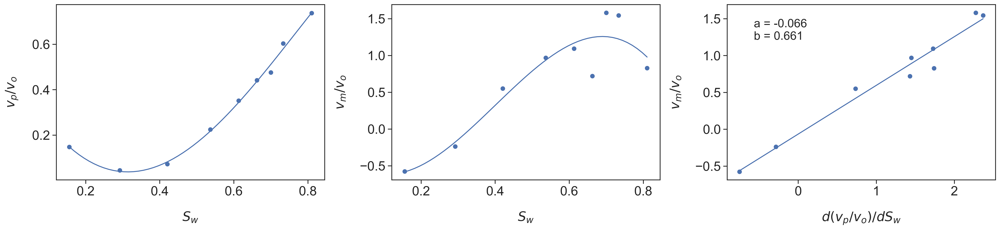

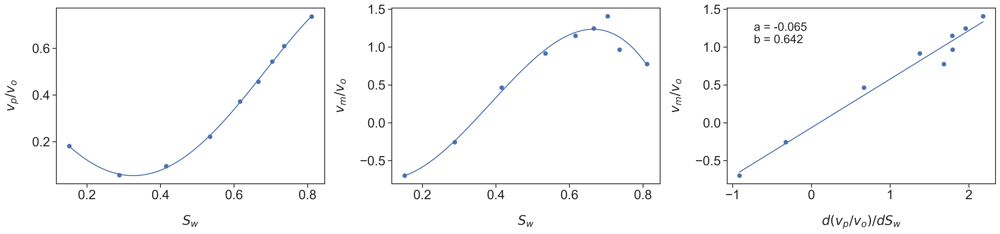

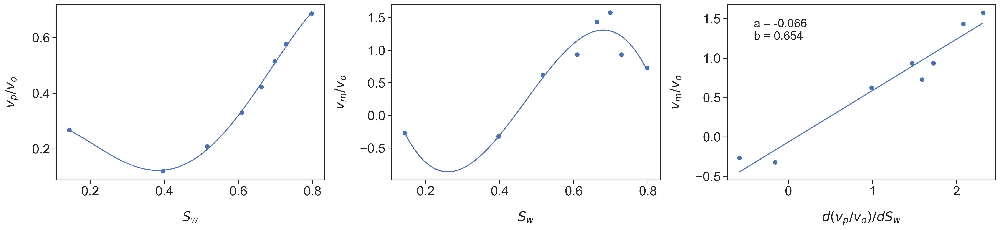

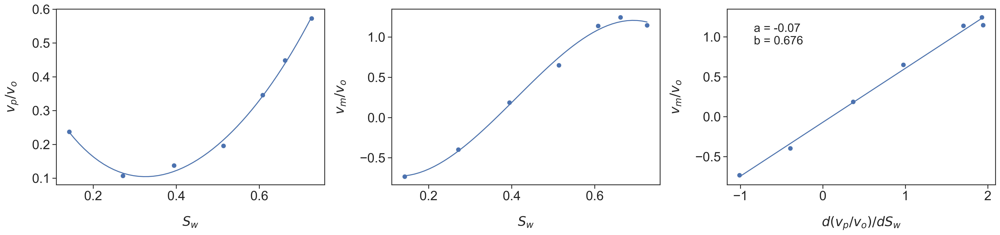

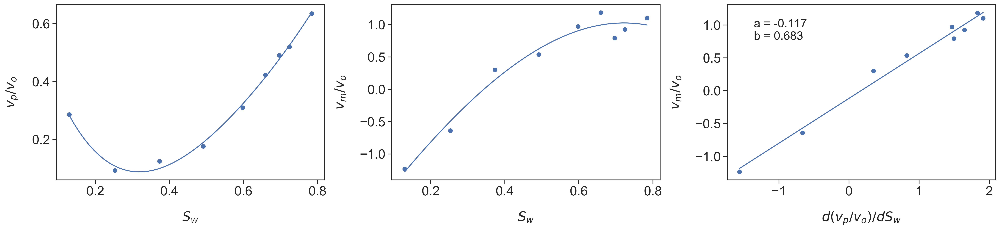

...

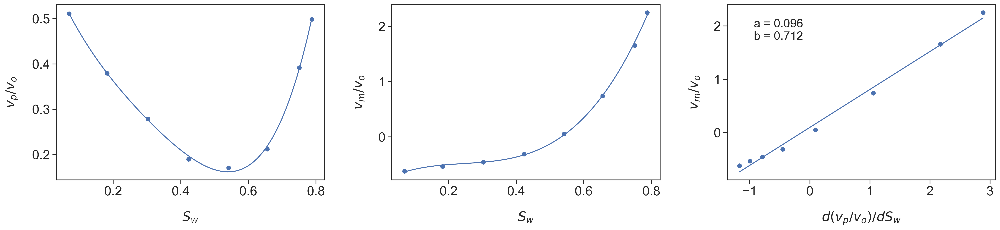

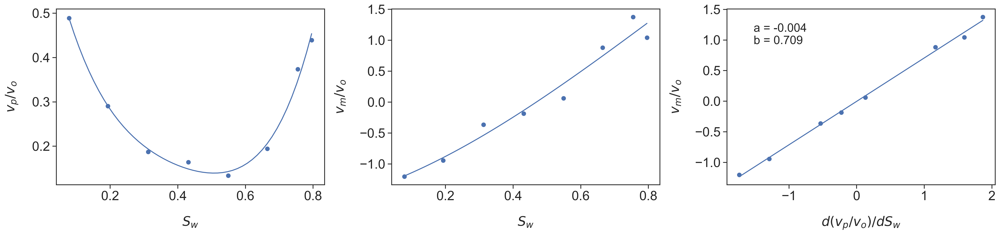

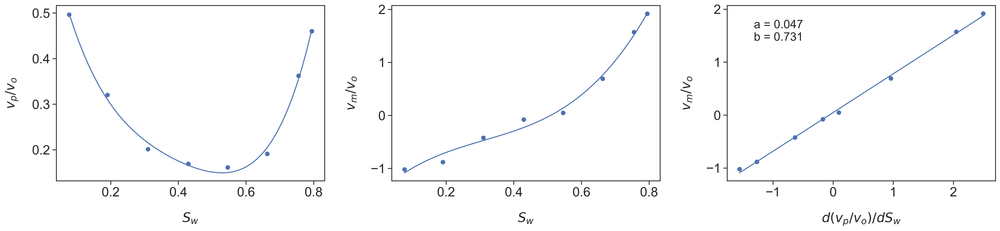

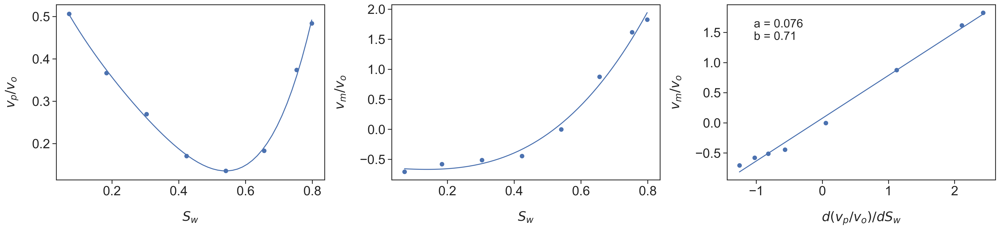

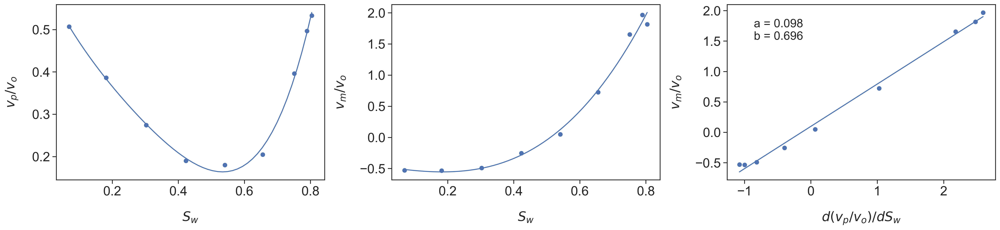

In [14]:
def fit_line(x,y, degree):
    z = np.polyfit(x, y, degree)
    f = np.poly1d(z)
    # calculate new x's and y's
    x_new = np.linspace(min(x), max(x), 50)
    y_new = f(x_new)
    return(x_new, y_new, f)

x_all1 = []
y_all1 = []
x_all2 = []
y_all2 = []
x_all3 = []
y_all3 = []
w_all = []

a = []
b = []
for k, case in enumerate (cases_data):
    
    plt.figure(k+1, figsize=(22,5), dpi=300)
    plt.subplot(1,3,1)
    plt.scatter(case['sw'], case['vp_vo'])
    x_new1, y_new1, _ = fit_line(case['sw'], case['vp_vo'],4)
    plt.plot(x_new1, y_new1)
    plt.xlabel('${S_w}$'), plt.ylabel('${v_p}/{v_o}$')
    #plt.title(' Wettability: '+str(round(case['wet_case'],2)), fontsize =16)
    
    plt.subplot(1,3,2)
    plt.scatter(case['sw'], case['vm_vo'])
    x_new2, y_new2, _ = fit_line(case['sw'], case['vm_vo'],3)
    plt.plot(x_new2, y_new2 )
    plt.xlabel('${S_w}$'), plt.ylabel('${v_m}/{v_o}$')
    
    ax = plt.subplot(1,3,3)
    plt.scatter(case['d_vp_vo_dsw'], case['vm_vo'])
    x_new3, y_new3, f = fit_line(case['d_vp_vo_dsw'], case['vm_vo'],1)
    a.append(f[0])
    b.append(f[1])
    plt.plot(x_new3, y_new3)
    t = 'a = '+str(round(f[0],3))+'\nb = '+str(round(f[1],3))
    plt.text(0.1, 0.8, t, fontsize =18, transform=ax.transAxes)
    plt.xlabel('$d({v_p}/{v_o})/{dS_w}$'), plt.ylabel('${v_m}/{v_o}$')
    plt.rcParams.update({'font.size': 20})
    plt.subplots_adjust(left=0.08,
                bottom=0.2, 
                right=0.99, 
                top=0.95, 
                wspace=0.25, 
                hspace=0.1)
    
    plt.savefig(os.path.join('./figures/',str(round(case['wet_case'],3))+'_wett.png'))
    plt.show()
    x_all3.extend(x_new3)
    y_all3.extend(y_new3)
    w_all.extend([case['wet_case'] for i in range (len(x_new1))])
    x_all1.extend(x_new1)
    y_all1.extend(y_new1)
    x_all2.extend(x_new2)
    y_all2.extend(y_new2)
    

<ipython-input-15-a09890465bd8>:49: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(x=x_all3, y=x_all3, palette='red', dashes =True)


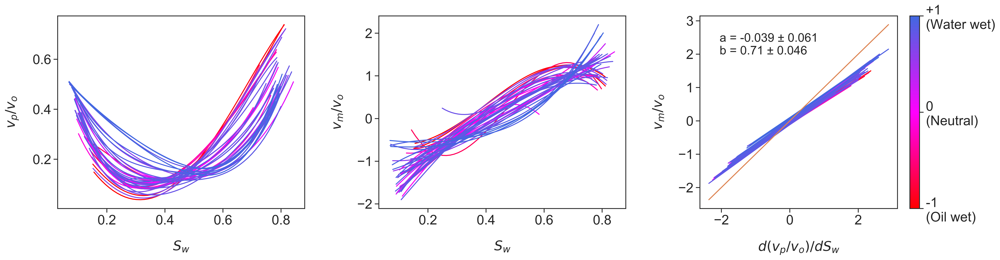

In [15]:
import seaborn as sns
import numpy as np
from matplotlib import cm
import statistics as stat
norm=plt.Normalize(1,150)
colorlist=['red','magenta',"royalblue"]
newcmp = LinearSegmentedColormap.from_list('testCmap', colors=colorlist, N=256)
palette= newcmp#'cool'

def add_stats(value, dec=3):
    avg = round(stat.mean(value),dec)
    std = round(stat.stdev(value),dec)
    if avg ==0 : avg=abs(avg)
    if std ==0 : std=abs(std)
    return(avg, std)



f = 20
rc = {'figure.dpi':300,
                  "font.size":1,
                  #"axes.titlesize":20,
                  "axes.labelsize":f,
                  'xtick.bottom': True,
                  'ytick.left': True,
                 'xtick.labelsize' : f,
                 'ytick.labelsize' : f,
                 'axes.labelpad': f}

# to add a and b 
a_avg, a_std = add_stats(a)
b_avg, b_std= add_stats(b)

t = 'a = '+str(a_avg) +' \u00b1 '+ str(a_std)+'\nb = '+str(b_avg) +' \u00b1 '+ str(b_std)

plt.figure(figsize=(23,5), dpi=500)
plt.subplot(1,3,1)
ax1 = sns.lineplot(x=x_all1, y=y_all1, hue=w_all, palette= palette)
ax1.set(xlabel='${S_w}$', ylabel='${v_p}/{v_o}$')
ax1.get_legend().remove()

plt.subplot(1,3,2)
ax2 = sns.lineplot(x=x_all2, y=y_all2, hue=w_all, palette= palette)
ax2.set(xlabel='${S_w}$', ylabel='${v_m}/{v_o}$')
ax2.get_legend().remove()

ax = plt.subplot(1,3,3)
ax2 = sns.lineplot(x=x_all3, y=y_all3, hue=w_all, palette= palette)
sns.lineplot(x=x_all3, y=x_all3, palette='red', dashes =True)
ax2.set(xlabel='$d({v_p}/{v_o})/{dS_w}$', ylabel='${v_m}/{v_o}$')
ax2.get_legend().remove()
ax2.text(0.1, 0.8, t, fontsize =18, transform=ax.transAxes)

norm = plt.Normalize(-1,1)#(min(all_wet), max(all_wet))
sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
sm.set_array([])

cbar = ax2.figure.colorbar(sm,ticks=[-1,0, 1])
cbar.ax.set_yticklabels(['-1 \n(Oil wet)','0 \n(Neutral)', '+1 \n(Water wet)']) 
#cbar.ax.set_yticklabels(['Oil wet', 'Water wet']) 

sns.set_theme(rc=rc,
              style="white")
plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.3, 
                    hspace=0.2)
plt.savefig(os.path.join('./figures/all_cases.png'), dpi=300, pad_inches = 0, bbox_inches = 'tight')
plt.show()

In [16]:

def add_stats(value, dec=3):
    avg = round(stat.mean(value),dec)
    std = round(stat.stdev(value),dec)
    if avg ==0 : avg=abs(avg)
    if std ==0 : std=abs(std)
    return(avg, std)

a_avg, a_std = add_stats(a)
b_avg, b_std= add_stats(b)
print('a', a_avg, a_std)
print('b', b_avg, b_std)

a -0.039 0.061
b 0.71 0.046


# According to wetting category

In [17]:
Homogeneous=["MineralModel_Case1","MineralModel_Case2","MineralModel_Case3","MineralModel_Case4","MineralModel_Case5","MineralModel_Case6","MineralModel_Case7"]
CornerWet=["MineralModel_Case8","MineralModel_Case9","MineralModel_Case10","MineralModel_Case11","MineralModel_Case12","MineralModel_Case13","MineralModel_Case14"]
Heterogeneous=["MineralModel_Case15","MineralModel_Case16","MineralModel_Case17","MineralModel_Case18","MineralModel_Case19","MineralModel_Case20","MineralModel_Case21","MineralModel_Case22","MineralModel_Case23","MineralModel_Case24","MineralModel_Case25","MineralModel_Case26","MineralModel_Case27"]
HeterogeneousCornerWet=["MineralModel_Case29","MineralModel_Case30","MineralModel_Case31","MineralModel_Case32","MineralModel_Case33","MineralModel_Case34","MineralModel_Case35","MineralModel_Case36","MineralModel_Case37","MineralModel_Case38","MineralModel_Case39","MineralModel_Case40","MineralModel_Case41","MineralModel_Case42"]
print(len(Homogeneous), len(CornerWet), len(Heterogeneous), len(HeterogeneousCornerWet))

7 7 13 14


In [18]:
categories = []
category_1 = [] #Homogeneous
category_2 = [] #CornerWet
category_3 = [] #Heterogeneous
category_4 = [] #HeterogeneousCornerWet

for case in cases_data:
    cat = str(case['file_name'][0])
    cat = cat.rstrip(cat[-1]) # remove the letter at the end of the names
    if cat in Homogeneous:
        category_1.append(case)
    elif cat in CornerWet:
        category_2.append(case)
    elif cat in Heterogeneous:
        category_3.append(case)
    else:
        category_4.append(case)
print(len(category_1), len(category_2), len(category_3), len(category_4))

7 7 13 14


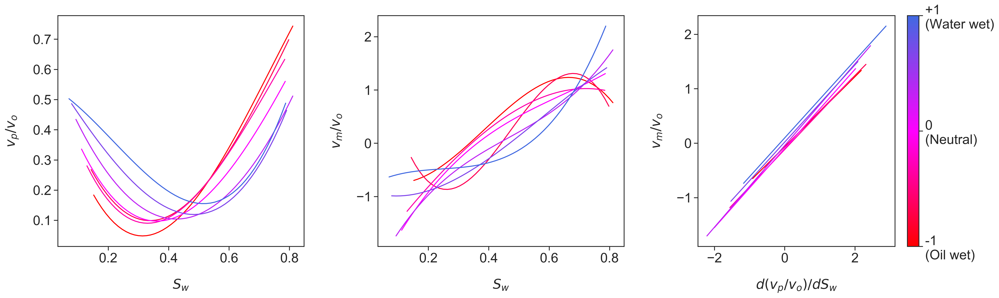

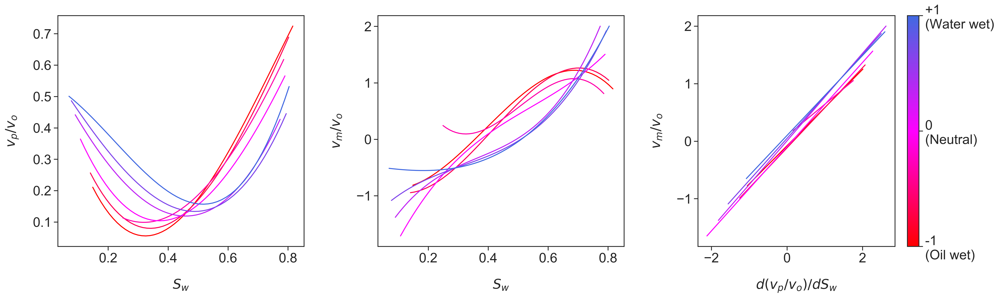

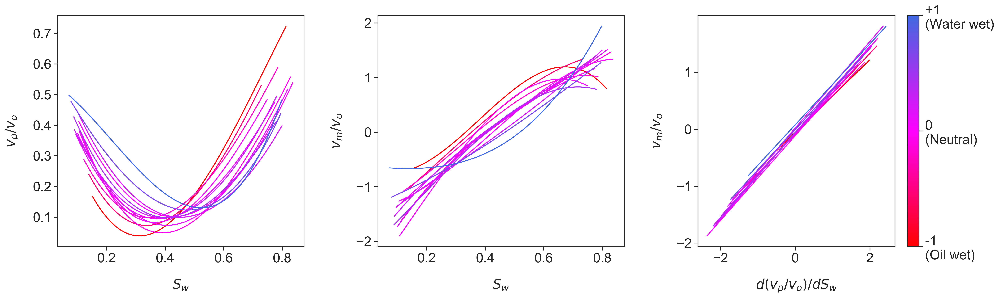

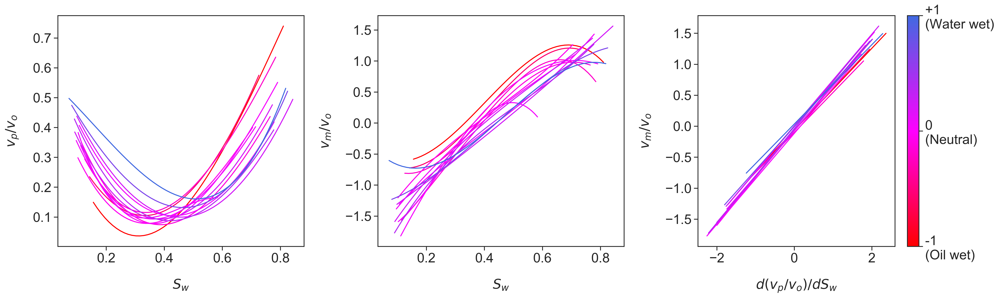

In [19]:
f = 20
rc = {'figure.dpi':300,
                  "font.size":1,
                  #"axes.titlesize":20,
                  "axes.labelsize":f,
                  'xtick.bottom': True,
                  'ytick.left': True,
                 'xtick.labelsize' : f,
                 'ytick.labelsize' : f,
                 'axes.labelpad': f}

def combine_curves(data,j, t):
    x_all1 = []
    y_all1 = []
    x_all2 = []
    y_all2 = []
    x_all3 = []
    y_all3 = []
    w_all = []
    for k, case in enumerate (data):
        x_new1, y_new1, _ = fit_line(case['sw'], case['vp_vo'],3)
        x_new2, y_new2, _ = fit_line(case['sw'], case['vm_vo'],3)
        x_new3, y_new3, f = fit_line(case['d_vp_vo_dsw'], case['vm_vo'],1)
        x_all3.extend(x_new3)
        y_all3.extend(y_new3)
        w_all.extend([case['wet_case'] for i in range (len(x_new1))])
        x_all1.extend(x_new1)
        y_all1.extend(y_new1)
        x_all2.extend(x_new2)
        y_all2.extend(y_new2)
        
    plt.figure(j, figsize=(23,6))
    plt.subplot(1,3,1)
    ax1 = sns.lineplot(x=x_all1, y=y_all1, hue=w_all, palette= palette)
    ax1.set(xlabel='${S_w}$', ylabel='${v_p}/{v_o}$')
    ax1.get_legend().remove()
    #plt.title(t, fontsize =20)

    plt.subplot(1,3,2)
    ax2 = sns.lineplot(x=x_all2, y=y_all2, hue=w_all, palette= palette)
    ax2.set(xlabel='${S_w}$', ylabel='${v_m}/{v_o}$')
    ax2.get_legend().remove()

    plt.subplot(1,3,3)
    ax2 = sns.lineplot(x=x_all3, y=y_all3, hue=w_all, palette= palette)
    ax2.set(xlabel='$d({v_p}/{v_o})/{dS_w}$', ylabel='${v_m}/{v_o}$')
    ax2.get_legend().remove()

    norm = plt.Normalize(-1,1)#(min(all_wet), max(all_wet))
    sm = plt.cm.ScalarMappable(cmap=palette, norm=norm)
    sm.set_array([])

    cbar = ax2.figure.colorbar(sm,ticks=[-1,0, 1])
    cbar.ax.set_yticklabels(['-1 \n(Oil wet)','0 \n(Neutral)', '+1 \n(Water wet)']) 
    #cbar.ax.set_yticklabels(['Oil wet', 'Water wet']) 

    sns.set_theme(rc=rc,
                  style="white")
    plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.3, 
                    hspace=0.2)
    plt.savefig(os.path.join('./figures/', t+'.png'), dpi=300, pad_inches = 0, bbox_inches = 'tight')

combine_curves(category_1,1, 'Homogeneous')
combine_curves(category_2,2, 'CornerWet')
combine_curves(category_3,3, 'Heterogeneous')
combine_curves(category_4,4, 'HeterogeneousCornerWet')